In [2]:
import numpy as np
from matplotlib import pyplot as plt
def plotear2(img,imgGray):
    fig = plt.figure(figsize=(15, 9))
    fig.add_subplot(1,2,1)
    plt.imshow(img,cmap='gray')
    plt.axis('off')
    plt.title("imagen original")
    fig.add_subplot(1,2,2)
    plt.imshow(imgGray,cmap='gray')
    plt.axis('off')
    plt.title("imagen filtrada")
    plt.show()


In [4]:
#cargar imagen 
import cv2 
path = r"E:\Septimo semestre\Procesamiento de imagenes\cerebros.jpg"


(8000, 6000, 3)

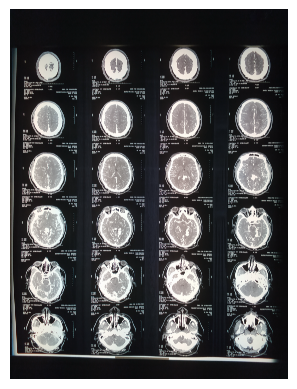

In [5]:
img = cv2.imread(path,cv2.COLOR_BGR2RGB)
#img = np.flip(img, axis=-1)
#success, img = img.read() 
img_convert = img.copy()
img_convert= cv2.cvtColor(img, cv2.COLOR_BGR2RGB) #defining image to experiment with number of clusters
plt.axis('off')
plt.imshow(img)
img.shape
img_convert.shape

In [8]:
vectorized = img.reshape((-1,3))
vectorized = np.float32(vectorized)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)

In [36]:
K = 25
attempts=10
# define criteria and apply kmeans()
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_PP_CENTERS)
center = np.uint8(center)
res = center[label.flatten()]
result_image1 = res.reshape((img_convert.shape))

In [9]:
K = 2
attempts=10
ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_PP_CENTERS)
center = np.uint8(center)
res = center[label.flatten()]
result_image3 = res.reshape((img_convert.shape))

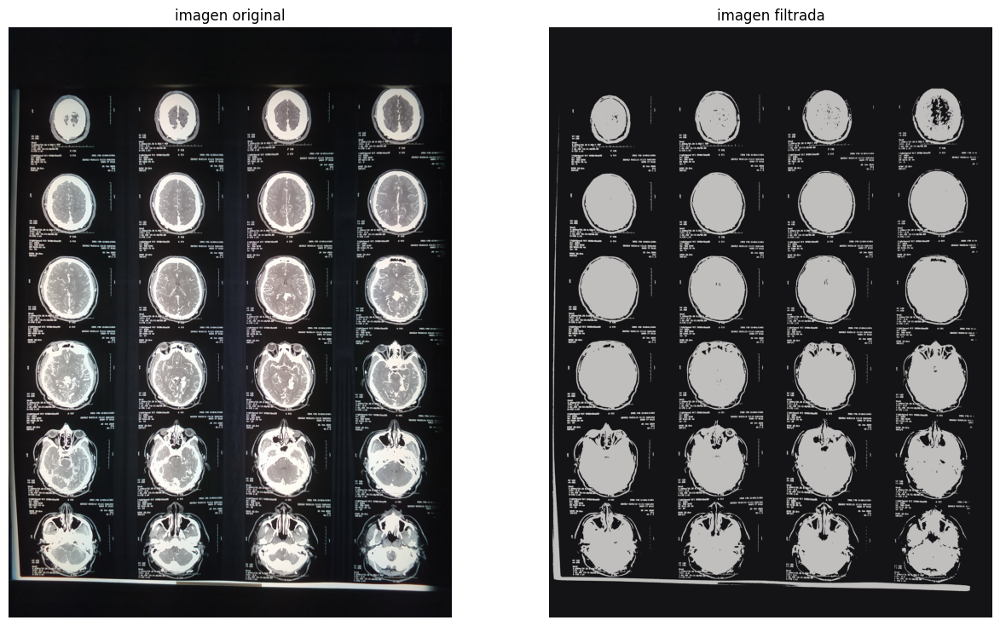

In [11]:
# plotear2(img,result_image1) 
plotear2(img,result_image3)

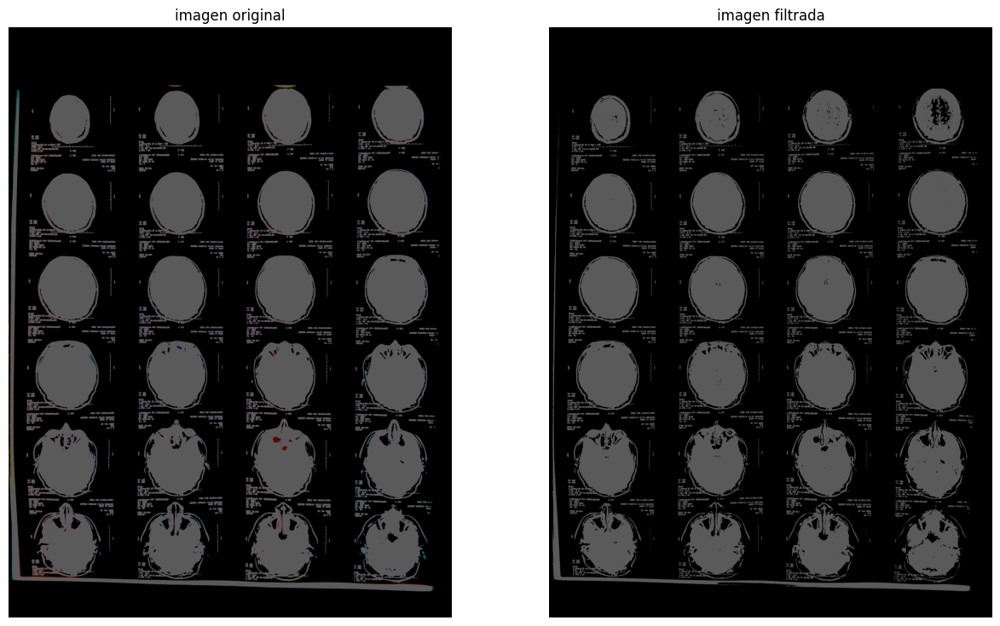

In [30]:
img = cv2.medianBlur(img,5)
#imgR = cv2.medianBlur(result_image3,5)
ret,th1 = cv2.threshold(img,60,90,cv2.THRESH_BINARY)
ret1,th2 = cv2.threshold(result_image3,60,90,cv2.THRESH_BINARY)
plotear2(th1,th2)


In [24]:
print(th2)

[[[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]]


In [32]:
#img5=  cv2.cvtColor(th2,cv2.IMREAD_GRAYSCALE) #cv2.IMREAD_GRAYSCALE
nb_components, output, stats, centroids = cv2.connectedComponentsWithStats(th1, connectivity=8)

sizes = stats[1:, -1]; nb_components = nb_components - 1

min_size = 100000 # Este tamaño es variable, yo he puesto 1000 
max_size = 700000 
img2 = np.zeros((output.shape))

for i in range(0, nb_components):
    if max_size >= sizes[i] >= min_size :
        img2[output == i + 1] = 255

error: OpenCV(4.6.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\connectedcomponents.cpp:5623: error: (-215:Assertion failed) L.channels() == 1 && I.channels() == 1 in function 'cv::connectedComponents_sub1'


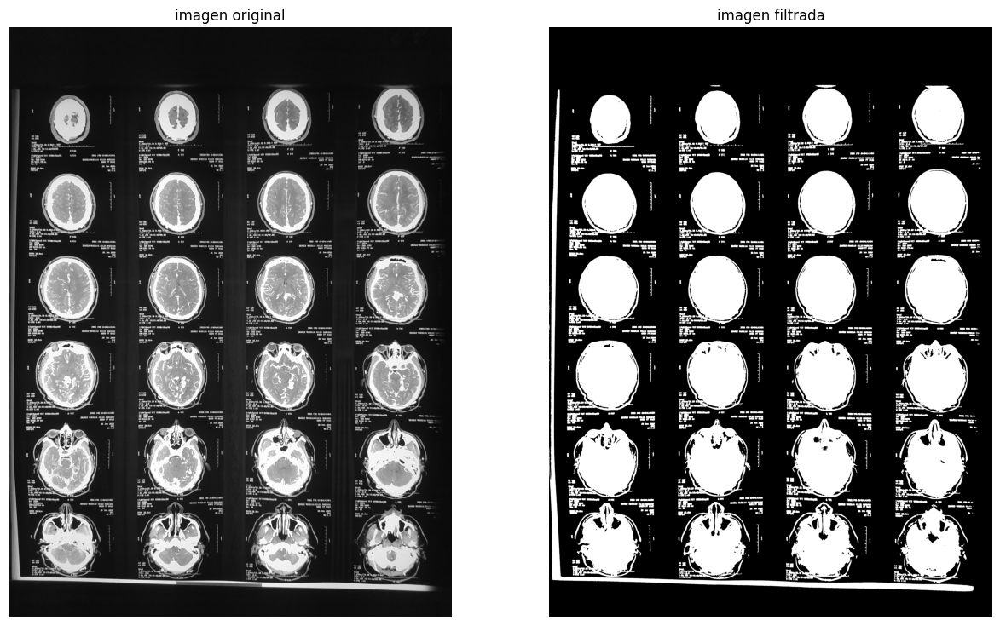

In [3]:
#img = cv.imread(r'C:\Users\Vostro\Downloads\IMG_20221026_142719.jpg',0)
img = cv.imread(r"E:\Septimo semestre\Procesamiento de imagenes\cerebros.jpg",0)
img = cv.medianBlur(img,5)
ret,th1 = cv.threshold(img,60,90,cv.THRESH_BINARY)
plotear2(img,th1)

In [21]:
th1.shape()

TypeError: 'tuple' object is not callable

In [4]:
nb_components, output, stats, centroids = cv.connectedComponentsWithStats(th1, connectivity=8)

sizes = stats[1:, -1]; nb_components = nb_components - 1

min_size = 100000 # Este tamaño es variable, yo he puesto 1000 
max_size = 700000 
img2 = np.zeros((output.shape))

for i in range(0, nb_components):
    if max_size >= sizes[i] >= min_size :
        img2[output == i + 1] = 255

In [5]:

import plotly
import plotly.express as px
import plotly.graph_objects as go
from skimage import data, filters, measure, morphology
mask = img2
labels = measure.label(mask)

fig = px.imshow(img, binary_string=True)
fig.update_traces(hoverinfo='skip') # hover is only for label info

props = measure.regionprops(labels, img)
properties = ['area', 'eccentricity', 'perimeter', 'intensity_mean']

# For each label, add a filled scatter trace for its contour,
# and display the properties of the label in the hover of this trace.
for index in range(0, labels.max()):
    label_i = props[index].label
    contour = measure.find_contours(labels == label_i, 0.5)[0]
    y, x = contour.T
    hoverinfo = ''
    for prop_name in properties:
        hoverinfo += f'<b>{prop_name}: {getattr(props[index], prop_name):.2f}</b><br>'
    fig.add_trace(go.Scatter(
        x=x, y=y, name=label_i,
        mode='lines', fill='toself', showlegend=False,
        hovertemplate=hoverinfo, hoveron='points+fills'))

plotly.io.show(fig)



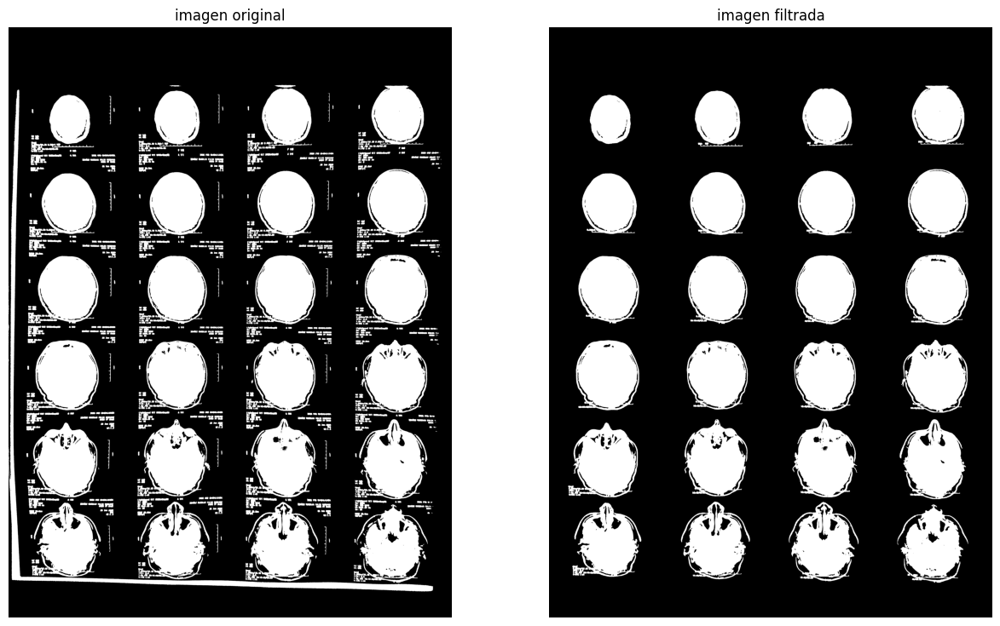

In [6]:
plotear2(th1,img2)

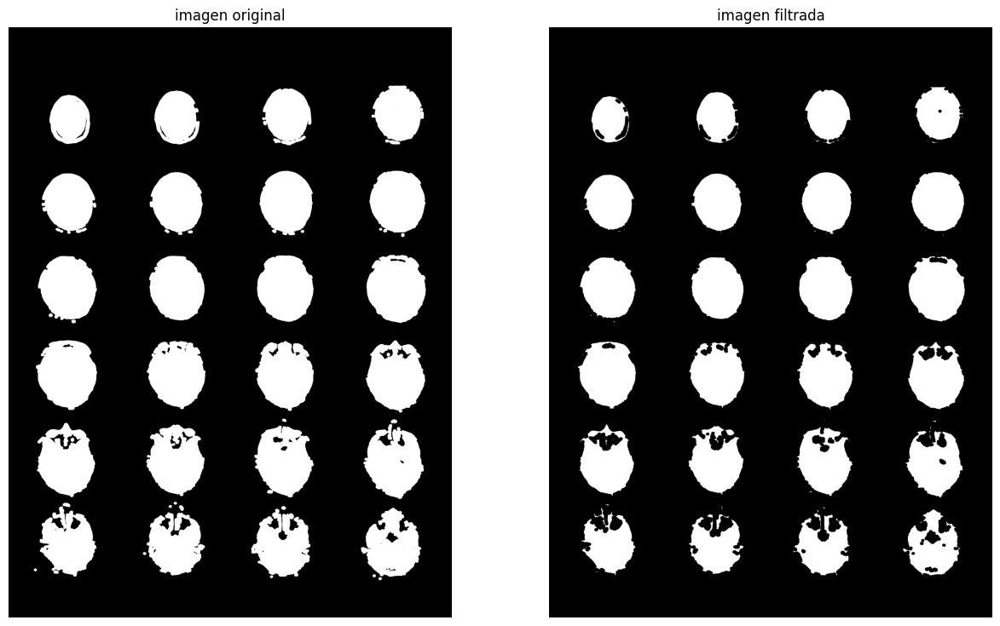

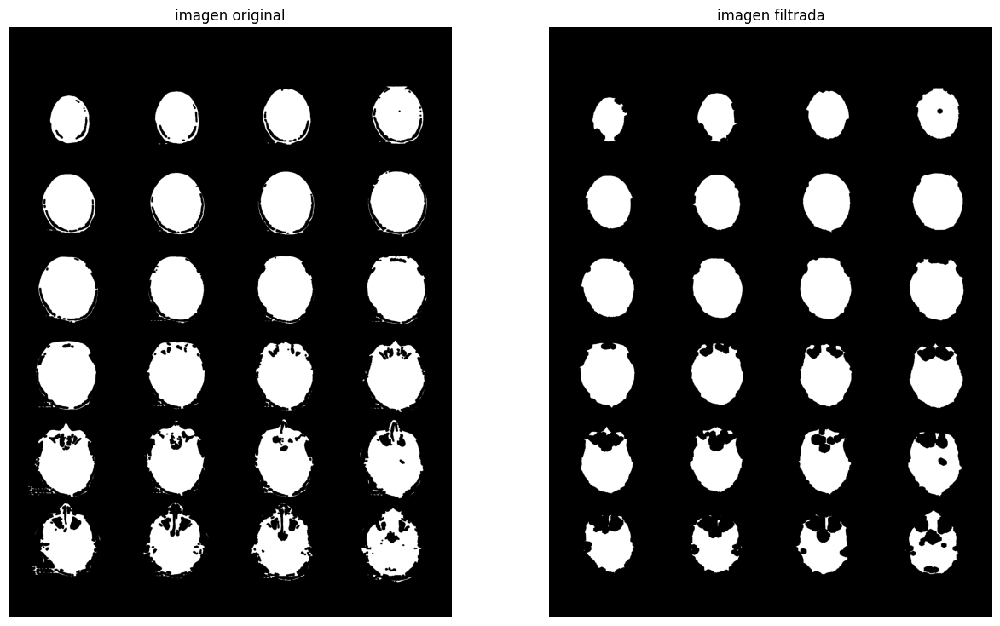

In [7]:
kernel = cv.getStructuringElement(cv.MORPH_ELLIPSE,(5,5))
ImgOut2 = cv.erode(img2,kernel,iterations = 5)
ImgOut3 = cv.dilate(ImgOut2,kernel,iterations = 5)
ImgOut4 = cv.erode(ImgOut3,kernel,iterations = 10)


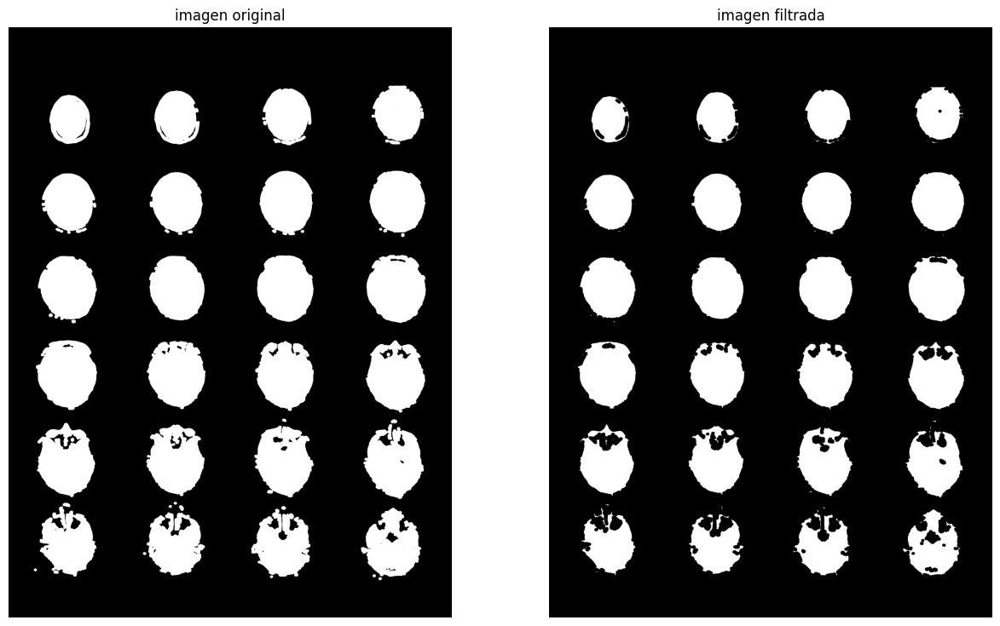

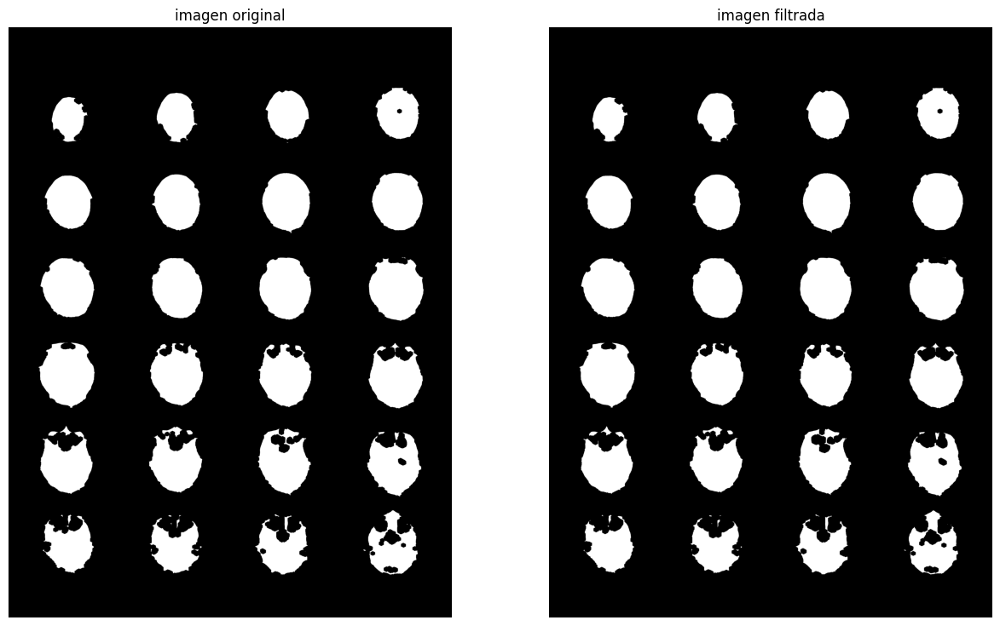

In [15]:
ImgOut5 = cv.dilate(ImgOut4,kernel,iterations = 10)
ImgOut6 = cv.erode(ImgOut5,kernel,iterations = 15)
ImgOut7 = cv.dilate(ImgOut6,kernel,iterations = 7)
ImgOut7 = cv.erode(ImgOut7,kernel,iterations = 8)
plotear2(ImgOut5,ImgOut4)
plotear2(ImgOut6,ImgOut7)

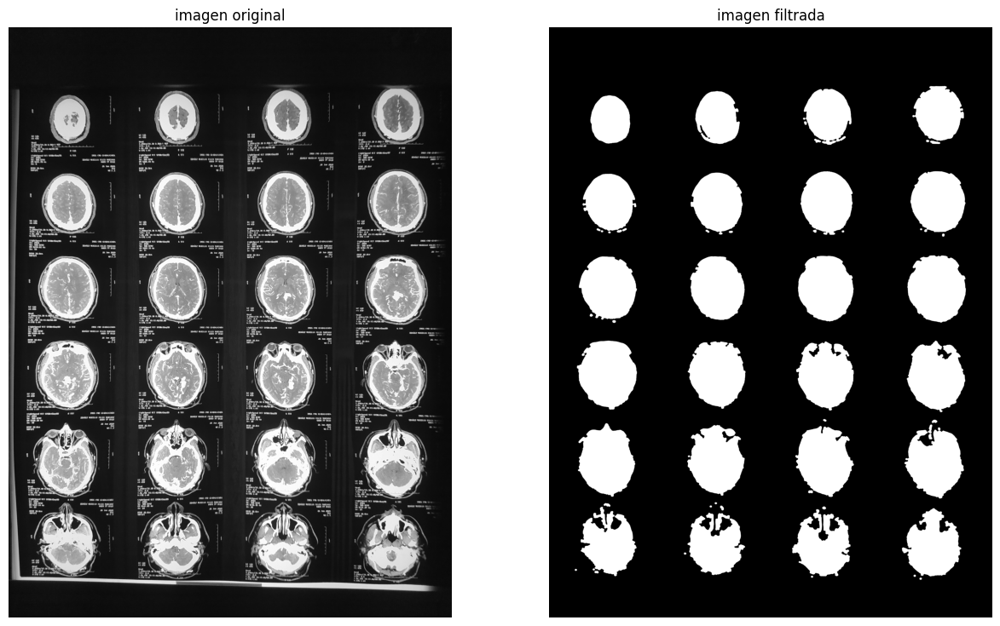

In [9]:
def rellenar(Img):
    ImFlood  = np.uint8(Img.copy())
    h,w = Img.shape[:2]
    img2 = np.uint8(Img)
    mask = np.zeros((h+2,w+2),np.uint8)
    cv.floodFill(ImFlood,mask,(0,0),255)

    ImFloodInv = cv.bitwise_not(ImFlood)

    ImgOut = img2| ImFloodInv
    return ImgOut

ImgOutR = rellenar(ImgOut7)
plotear2(img,ImgOutR)


In [92]:
import plotly
import plotly.express as px
import plotly.graph_objects as go
from skimage import data, filters, measure, morphology
mask = ImgOutR
labels = measure.label(mask)

fig = px.imshow(img, binary_string=True)
fig.update_traces(hoverinfo='skip') # hover is only for label info

props = measure.regionprops(labels, img)
properties = ['area', 'eccentricity', 'perimeter', 'intensity_mean']

# For each label, add a filled scatter trace for its contour,
# and display the properties of the label in the hover of this trace.
for index in range(0, labels.max()):
    label_i = props[index].label
    contour = measure.find_contours(labels == label_i, 0.5)[0]
    y, x = contour.T
    hoverinfo = ''
    for prop_name in properties:
        hoverinfo += f'<b>{prop_name}: {getattr(props[index], prop_name):.2f}</b><br>'
    fig.add_trace(go.Scatter(
        x=x, y=y, name=label_i,
        mode='lines', fill='toself', showlegend=False,
        hovertemplate=hoverinfo, hoveron='points+fills'))

plotly.io.show(fig)

In [ ]:
from skimage import data, filters, measure, morphology
mask = ImgOutR
labels = measure.label(mask)

In [93]:
import math
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from skimage.draw import ellipse
from skimage.measure import label, regionprops, regionprops_table
from skimage.transform import rotate
#props = regionprops(ImgOutR)
#print(props)
#pd.DataFrame(props)
props = regionprops_table(ImgOutR, properties=('centroid',
                                                 'orientation',
                                                 'axis_major_length',
                                                 'axis_minor_length'))

In [94]:
pd.DataFrame(props)

,centroid-0,centroid-1,orientation,axis_major_length,axis_minor_length
0,4444.313389,3074.662585,-0.193097,7638.127251,6635.891242


In [ ]:
# cortar imagenes mediante su area 
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import glob
import pandas as pd 

def cortarImagen(img):
    #obtener centroides
    nb_components, output, stats, centroids = cv2.connectedComponentsWithStats(img, connectivity=8)
    #obtener areas
    sizes = stats[1:, -1]; nb_components = nb_components - 1    
    #obtener centroides
    centroids = centroids[1:,]
    #encerrar areas en un cuadrado
    for i in range(0, nb_components):   
        x = int(centroids[i,0])
        y = int(centroids[i,1])
        area = int(sizes[i])
        #print(area)
        #print(x)
        #print(y)
        #print(" ")
        if area > 100000:
            img = img[y-area:y+area,x-area:x+area]
            return img
        else:
            return img